In [1]:
import robin_stocks.robinhood as r

In [165]:
#from tensorflow import keras
import pandas as pd
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow import keras

In [3]:
import pandas as pd
import numpy as np
import os
from tqdm.autonotebook import tqdm
tqdm.pandas()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:4: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  after removing the cwd from sys.path.


In [4]:
from sklearn.neighbors import kneighbors_graph
from sklearn.cluster import AgglomerativeClustering

In [5]:
import plotly.graph_objects as go
import plotly.express as px

import plotly.offline as pyo
import plotly.graph_objs as go
# Set notebook mode to work in offline
pyo.init_notebook_mode()

In [6]:
import plotly.io as pio
pio.templates.default = "plotly_dark"

In [7]:
import sys
sys.path.append('../')

In [8]:
from utils import file_manager, plotters, portfolio_manager
import importlib

In [9]:
login = r.login('omai.r@icloud.com','')

In [10]:
account = r.profiles.load_account_profile()

In [43]:
importlib.reload(file_manager)

<module 'utils.file_manager' from '../utils/file_manager.py'>

In [44]:
fm = file_manager.FileManager(r, '5min_weekly')

Initialized


In [45]:
importlib.reload(portfolio_manager)

<module 'utils.portfolio_manager' from '../utils/portfolio_manager.py'>

In [46]:
pm = portfolio_manager.PortfolioManager(r)


In [ ]:
portfolio_df = pm.load_portfolio()

In [38]:
portfolio_df.head()

,price,quantity,average_buy_price,equity,percent_change,equity_change,type,name,id,pe_ratio,percentage
ABT,116.310000,2.00000000,105.1750,232.62,10.59,22.270000,stock,Abbott,2018c0a7-2525-4dee-8de4-b6fb2c1f286e,37.236200,0.60
TMO,456.250000,1.00000000,453.7433,456.25,0.55,2.506700,stock,Thermo Fisher Scientific,9b7ab2ce-b812-4497-b71a-a68d4b57e384,23.312400,1.17
AAPL,122.750000,10.00000000,125.1115,1227.50,-1.89,-23.615000,stock,Apple,450dfc6d-5510-4d40-abfb-f633b7d9be3e,28.464700,3.15
MSFT,239.020000,10.00000000,228.8869,2390.20,4.43,101.331000,stock,Microsoft,50810c35-d215-4866-9758-0ada4ac79ffa,33.637300,6.13
NVTA,26.760000,1.00000000,47.7500,26.76,-43.96,-20.990000,stock,Invitae,fb0e591f-f907-4b2b-b1fd-eaf5083f2c85,None,0.07


In [13]:
watchlist_df = pm.load_watchlists()


  0%|          | 0/11 [00:00<?, ?it/s]

In [40]:
watchlist_df.head().columns

Index(['created_at', 'id', 'list_id', 'object_id', 'object_type', 'owner_type',
       'updated_at', 'weight', 'market_cap', 'name', 'open_positions',
       'symbol', 'uk_tradability', 'us_tradability', 'state',
       'ipo_access_status', 'holdings', 'one_day_dollar_change',
       'one_day_percent_change', 'one_day_rolling_dollar_change',
       'one_day_rolling_percent_change', 'price', 'watchlist'],
      dtype='object')

## Start here

In [132]:
importlib.reload(portfolio_manager)
pm = portfolio_manager.PortfolioManager(r, load = True)
portfolio_df = pm.load_portfolio()

importlib.reload(file_manager)
fm = file_manager.FileManager(r, 'daily_5year')

  0%|          | 0/12 [00:00<?, ?it/s]

Initialized


In [19]:
_test = fm.update_disk(r, list(watchlist_df['symbol']))

Writing Files..:   0%|          | 0/523 [00:00<?, ?it/s]

In [27]:
timelines_df = fm.read_from_disk(list(watchlist_df['symbol']))

Reading Files for ../data/stock_data/daily_5year..:   0%|          | 0/523 [00:00<?, ?it/s]

In [31]:
px.line(timelines_df['open_price']['FB'].values)

In [101]:
fm.update_disk(r, list(portfolio_df.index))
fm.update_disk(r, list(watchlist_df['symbol']))

Writing Files..:   0%|          | 0/76 [00:00<?, ?it/s]

,open_price,close_price,high_price,low_price,volume,session,interpolated,symbol
begins_at,,,,,,,,
2016-05-12T00:00:00Z,38.16,38.00,38.1701,37.5200,10395442,reg,False,ABT
2016-05-13T00:00:00Z,37.94,37.60,38.0561,37.4700,9337889,reg,False,ABT
2016-05-16T00:00:00Z,37.60,38.25,38.4100,37.6000,10178499,reg,False,ABT
2016-05-17T00:00:00Z,38.20,37.71,38.3000,37.5500,8357129,reg,False,ABT
2016-05-18T00:00:00Z,37.79,37.75,38.1000,37.4900,10641315,reg,False,ABT
...,...,...,...,...,...,...,...,...
2021-05-05T00:00:00Z,128.17,128.52,129.5000,127.4950,433920,reg,False,AZPN
2021-05-06T00:00:00Z,128.53,128.22,128.5300,124.3032,471350,reg,False,AZPN
2021-05-07T00:00:00Z,129.20,127.07,131.0800,126.7350,349783,reg,False,AZPN


In [146]:
fm.update_disk(r, list(watchlist_df['symbol']))

Writing Files..:   0%|          | 0/523 [00:00<?, ?it/s]

,open_price,close_price,high_price,low_price,volume,session,interpolated,symbol
begins_at,,,,,,,,
2016-05-10T00:00:00Z,13.8750,13.87,13.875,13.8700,781,reg,False,CPER
2016-05-11T00:00:00Z,13.8700,13.87,13.870,13.8700,394,reg,False,CPER
2016-05-12T00:00:00Z,14.0400,13.81,14.040,13.6980,635,reg,False,CPER
2016-05-13T00:00:00Z,13.7456,13.90,13.900,13.7456,575,reg,False,CPER
2016-05-16T00:00:00Z,13.9000,13.87,13.990,13.8700,685,reg,False,CPER
...,...,...,...,...,...,...,...,...
2021-05-05T00:00:00Z,0.0000,0.00,0.000,0.0000,0,reg,True,REVH
2021-05-06T00:00:00Z,0.0000,0.00,0.000,0.0000,0,reg,True,REVH
2021-05-07T00:00:00Z,0.0000,0.00,0.000,0.0000,0,reg,True,REVH


In [151]:
importlib.reload(plotters)
rb_plotter = plotters.Plotter(r, pm, 'daily_5year', 'all')

Initialized


  0%|          | 0/12 [00:00<?, ?it/s]

In [154]:
fig, heat_data = rb_plotter.generate_time_heatmap(selected_ohcl = 'close_price', n_clusters = 15)

#heat_data, portfolio_change = rb_plotter.generate_time_heatmap()

Reading Files for ../data/stock_data/daily_5year..:   0%|          | 0/552 [00:00<?, ?it/s]

In [155]:
fig.show()

In [157]:
df = heat_data

In [329]:
list(df.columns).index('ARKK')

67

In [397]:
split_fraction = 0.7
train_split = int(split_fraction * int(df.shape[0]))
step = 1

past = 90
future = 2
learning_rate = 0.0001
batch_size = 128
epochs = 100

target_col = list(df.columns).index('ARKK')

def normalize(data, train_split):
    
    kind = 'minmax'
    
    if kind == 'std':
        data_mean = data[:train_split].mean(axis=0)
        data_std = data[:train_split].std(axis=0)
        return (data - data_mean) / (data_std * 6)

    if kind == 'minmax':
        from sklearn.preprocessing import MinMaxScaler
        scaler = MinMaxScaler()
        return scaler.fit_transform(data)
        

In [370]:
df

symbol,CUE,DCPH,RDUS,RGEN,CRL,CRIS,CRBP,CNCE,RUBY,SAGE,...,EPRSQ,EOT,EOS,EOI,ENX,ENTR,ENTG,ENTA,ETTX,ZTR
begins_at,,,,,,,,,,,,,,,,,,,,,
2016-05-10T00:00:00Z,0.000000,0.000000,-0.040859,-0.027550,-0.023807,-0.052083,-0.008163,-0.011246,0.000000,-0.052297,...,-0.194444,0.005755,-0.000779,-0.002357,0.004895,0.000000,-0.012763,-0.017945,0.000000,-0.006584
2016-05-11T00:00:00Z,0.000000,0.000000,-0.058458,0.007274,-0.007194,-0.032967,-0.012346,-0.039810,0.000000,-0.034756,...,-0.100230,0.003081,0.000779,0.006299,0.000696,0.000000,-0.018251,-0.006645,0.000000,0.001657
2016-05-12T00:00:00Z,0.000000,0.000000,0.006605,-0.004561,0.017072,-0.045455,-0.037500,0.098717,0.000000,0.013582,...,0.000383,-0.000439,-0.003894,-0.002347,-0.002086,0.000000,0.003873,0.027174,0.000000,-0.016543
2016-05-13T00:00:00Z,0.000000,0.000000,0.033465,0.005346,0.013887,0.017857,0.012987,0.044924,0.000000,0.021814,...,0.008811,0.001317,0.003909,0.013333,0.004181,0.000000,0.014660,-0.004477,0.000000,0.008410
2016-05-16T00:00:00Z,0.000000,0.000000,0.049841,-0.036840,-0.002739,-0.029240,0.029915,0.054170,0.000000,-0.028667,...,-0.177215,-0.001754,0.003894,0.008514,-0.005552,0.000000,-0.023574,-0.041701,0.000000,0.000834
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-05-05T00:00:00Z,-0.031972,-0.066991,-0.027338,-0.049227,-0.024246,-0.020588,-0.088757,0.017766,-0.002786,0.017938,...,-0.119565,0.005369,-0.004016,0.003356,0.003968,-0.014656,0.005420,-0.020549,-0.026738,0.002988
2021-05-06T00:00:00Z,0.033028,-0.006080,0.015779,0.013929,0.016952,0.026026,0.071429,0.000000,0.043496,0.041626,...,-0.341564,-0.004005,0.008065,0.009476,-0.003162,0.015039,0.030638,-0.049020,0.046703,0.003972
2021-05-07T00:00:00Z,0.277087,-0.041363,-0.031068,-0.067465,-0.028229,-0.050732,-0.048485,-0.059850,-0.046272,-0.002398,...,0.343750,0.002681,-0.016889,-0.009939,0.000000,-0.025683,-0.056752,-0.017732,-0.039370,-0.003956


In [371]:
selected_features = list(df.columns)
features = df[selected_features]

features = normalize(features.values, train_split)
features = pd.DataFrame(features)
features.head()

,0,1,2,3,4,5,6,7,8,9,...,542,543,544,545,546,547,548,549,550,551
0,0.423671,0.192358,0.559333,0.335801,0.537730,0.081448,0.579667,0.360024,0.316618,0.419686,...,0.243295,0.672474,0.510008,0.554652,0.514225,0.570571,0.394210,0.548301,0.223837,0.665047
1,0.423671,0.192358,0.527031,0.435898,0.592056,0.090005,0.576437,0.331098,0.316618,0.433209,...,0.275783,0.656246,0.516302,0.588550,0.485489,0.570571,0.374000,0.576187,0.223837,0.685753
2,0.423671,0.192358,0.646452,0.401880,0.671410,0.084416,0.557015,0.471380,0.316618,0.470474,...,0.310477,0.634883,0.497426,0.554688,0.466450,0.570571,0.455470,0.659645,0.223837,0.640027
3,0.423671,0.192358,0.695752,0.430354,0.660995,0.112755,0.595997,0.416906,0.316618,0.476821,...,0.313383,0.645539,0.528944,0.616097,0.509340,0.570571,0.495194,0.581536,0.223837,0.702721
4,0.423671,0.192358,0.725811,0.309099,0.606624,0.091674,0.609067,0.426269,0.316618,0.437903,...,0.249236,0.626902,0.528882,0.597223,0.442735,0.570571,0.354398,0.489675,0.223837,0.683685


In [372]:
train_data = features.loc[0 : train_split - 1]
val_data = features.loc[train_split:]

In [373]:
start = past + future
end = start + train_split

#x_train = train_data[[i for i in range(7)]].values
x_train = train_data.values
y_train = features.iloc[start:end][[target_col]]

sequence_length = int(past / step)

In [374]:
dataset_train = keras.preprocessing.timeseries_dataset_from_array(
    x_train,
    y_train,
    sequence_length=sequence_length,
    sampling_rate=step,
    batch_size=batch_size,
)

In [375]:
y_train

,67
92,0.611743
93,0.563202
94,0.707706
95,0.600642
96,0.569347
...,...
970,0.812580
971,0.242820
972,0.945103
973,0.603145


In [376]:
x_end = len(val_data) - past - future

label_start = train_split + past + future

#x_val = val_data.iloc[:x_end][[i for i in range(7)]].values
x_val = val_data.iloc[:x_end].values
y_val = features.iloc[label_start:][[target_col]]

dataset_val = keras.preprocessing.timeseries_dataset_from_array(
    x_val,
    y_val,
    sequence_length=sequence_length,
    sampling_rate=step,
    batch_size=batch_size,
)


for batch in dataset_train.take(1):
    inputs, targets = batch

print("Input shape:", inputs.numpy().shape)
print("Target shape:", targets.numpy().shape)

Input shape: (128, 90, 552)
Target shape: (128, 1)


In [398]:
inputs = keras.layers.Input(shape=(inputs.shape[1], inputs.shape[2]))
lstm_out = keras.layers.LSTM(32, kernel_initializer='uniform' ,activation = 'relu')(inputs)
outputs = keras.layers.Dense(1, kernel_initializer='uniform', activation = 'relu')(lstm_out)

model = keras.Model(inputs=inputs, outputs=outputs)
opt = keras.optimizers.SGD(lr=learning_rate, momentum=0.9, clipvalue=1.0)
#opt = keras.optimizers.Adam(learning_rate=learning_rate)
model.compile(optimizer=opt, loss="mean_squared_error")
model.summary()

Model: "model_27"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_28 (InputLayer)        [(None, 90, 552)]         0         
_________________________________________________________________
lstm_27 (LSTM)               (None, 32)                74880     
_________________________________________________________________
dense_27 (Dense)             (None, 1)                 33        
Total params: 74,913
Trainable params: 74,913
Non-trainable params: 0
_________________________________________________________________


In [399]:
train_data.shape

(883, 552)

In [400]:
train_data.max().max()

1.0000000000000002

In [401]:
y_val.shape

(287, 1)

In [402]:
y_val.max().max()

1.0

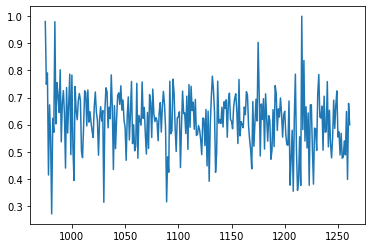

In [403]:
plt.plot(y_val)

In [408]:
path_checkpoint = "model_checkpoint.h5"
es_callback = keras.callbacks.EarlyStopping(monitor="val_loss", min_delta=0, patience=5)

modelckpt_callback = keras.callbacks.ModelCheckpoint(
    monitor="val_loss",
    filepath=path_checkpoint,
    verbose=1,
    save_weights_only=True,
    save_best_only=True,
)

history = model.fit(
    dataset_train,
    epochs=epochs,
    validation_data=dataset_val,
    callbacks=[es_callback, modelckpt_callback],
)

7/7 [==============================] - 1s 209ms/step - loss: 0.0039 - val_loss: 0.0125

Epoch 00001: val_loss improved from inf to 0.01245, saving model to model_checkpoint.h5


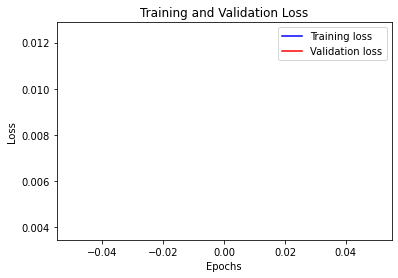

In [409]:
def visualize_loss(history, title):
    loss = history.history["loss"]
    val_loss = history.history["val_loss"]
    epochs = range(len(loss))
    plt.figure()
    plt.plot(epochs, loss, "b", label="Training loss")
    plt.plot(epochs, val_loss, "r", label="Validation loss")
    plt.title(title)
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.legend()
    plt.show()


visualize_loss(history, "Training and Validation Loss")

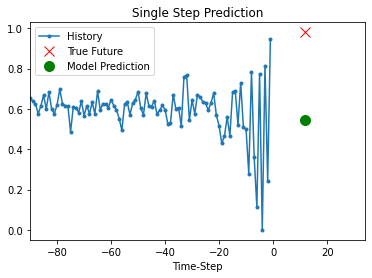

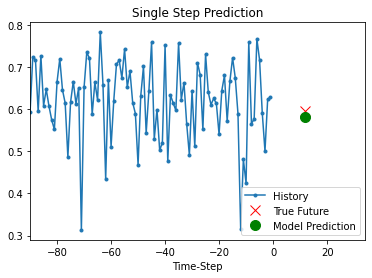

In [411]:
def show_plot(plot_data, delta, title):
    labels = ["History", "True Future", "Model Prediction"]
    marker = [".-", "rx", "go"]
    time_steps = list(range(-(plot_data[0].shape[0]), 0))
    if delta:
        future = delta
    else:
        future = 0

    plt.title(title)
    for i, val in enumerate(plot_data):
        if i:
            plt.plot(future, plot_data[i], marker[i], markersize=10, label=labels[i])
        else:
            plt.plot(time_steps, plot_data[i].flatten(), marker[i], label=labels[i])
    plt.legend()
    plt.xlim([time_steps[0], (future + 5) * 2])
    plt.xlabel("Time-Step")
    plt.show()
    return


for x, y in dataset_val.take(5):
    show_plot(
        [x[0][:, target_col].numpy(), y[0].numpy(), model.predict(x)[0]],
        12,
        "Single Step Prediction",
    )

In [388]:
y

<tf.Tensor: shape=(70, 1), dtype=float64, numpy=
array([[0.59688725],
       [0.7238179 ],
       [0.64019767],
       [0.6431185 ],
       [0.56714111],
       [0.70529479],
       [0.50873055],
       [0.7478509 ],
       [0.59024753],
       [0.74143487],
       [0.65181509],
       [0.6828539 ],
       [0.58297522],
       [0.69306817],
       [0.56017159],
       [0.56422329],
       [0.59645546],
       [0.57998001],
       [0.5456443 ],
       [0.48918292],
       [0.62382007],
       [0.6224911 ],
       [0.52226714],
       [0.65567644],
       [0.44772382],
       [0.64942502],
       [0.39065467],
       [0.59949825],
       [0.69907168],
       [0.77872209],
       [0.72967368],
       [0.64715682],
       [0.42381806],
       [0.4936406 ],
       [0.76026041],
       [0.60530943],
       [0.61891621],
       [0.60449329],
       [0.66439517],
       [0.59109322],
       [0.68438495],
       [0.66017901],
       [0.6914989 ],
       [0.55323007],
       [0.68389452],
      

In [393]:
x[0][:,67].shape

TensorShape([90])

In [390]:
model.predict(x).shape

(70, 1)

In [391]:
model.predict(x)[1]

array([0.05324486], dtype=float32)